In [1]:
from utils import Dataset, nms, plot_image, convert_cells_to_bboxes, preprocess_log_minmax
from astropy.io import fits
import numpy as np
import matplotlib.pyplot as plt
import torch

In [2]:
anchors = np.load('/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/anchors.npy') / 4096
IMAGE_SIZE = 2048
GRID_SIZES = [IMAGE_SIZE//32, IMAGE_SIZE//16, IMAGE_SIZE//8]
    
scaled_anchors = (
    torch.tensor(anchors) *
    torch.tensor(GRID_SIZES).unsqueeze(1).unsqueeze(1).repeat(1,3,2)
)

In [3]:
dataset = Dataset('/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images',
                     '/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/labels', anchors=anchors, grid_sizes=GRID_SIZES, image_size=2048)

In [4]:
loader = torch.utils.data.DataLoader(dataset, 8)

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_01_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_01_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_01_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_01_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_01_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_01_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_02_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_02_04_01_

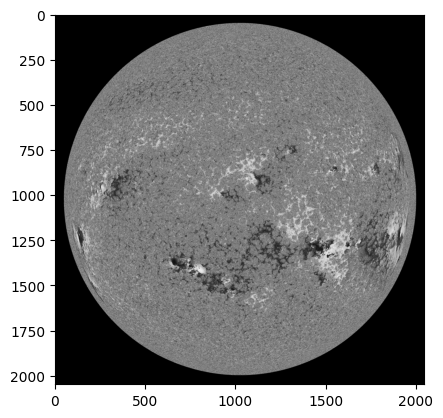

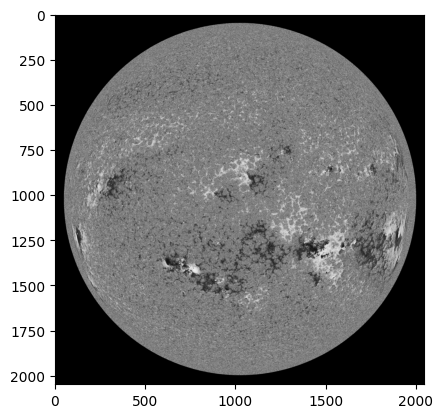

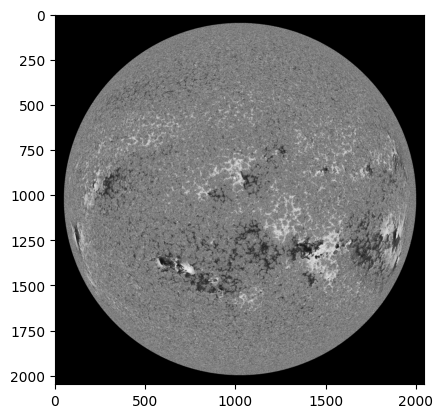

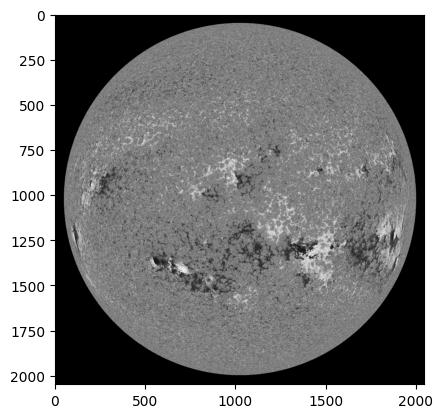

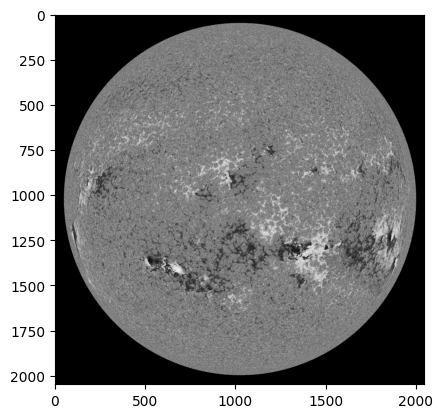

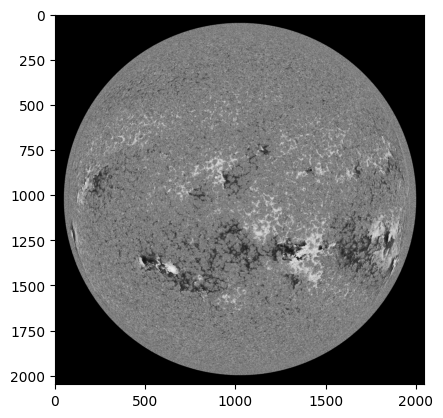

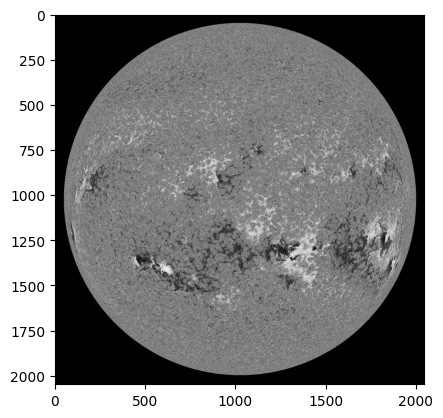

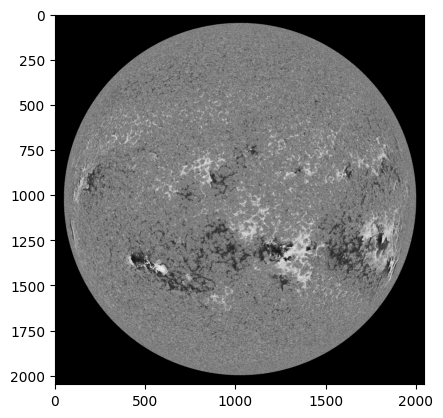

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_02_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_02_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_02_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_02_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_03_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_03_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_03_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_03_12_01_

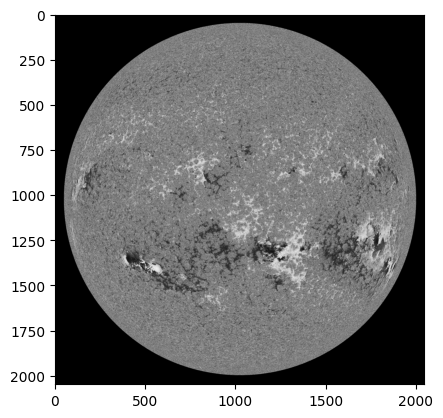

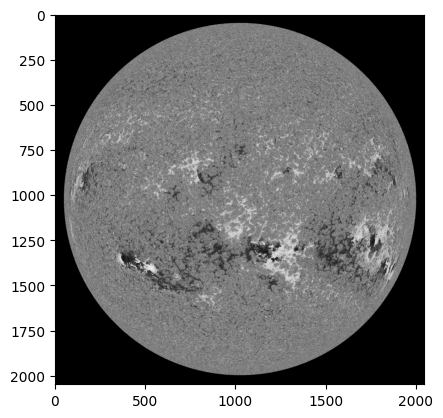

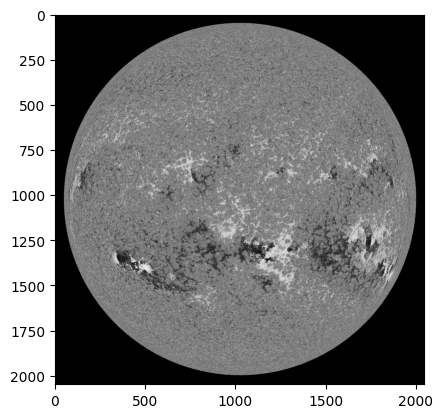

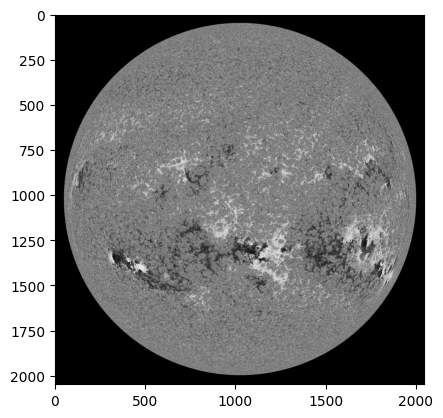

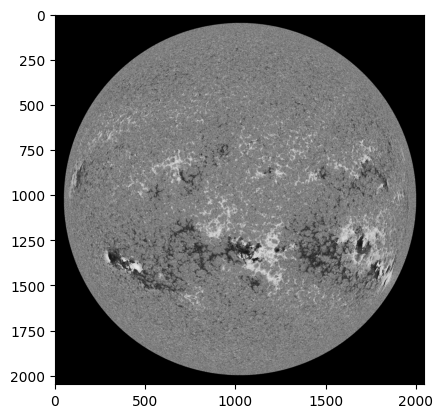

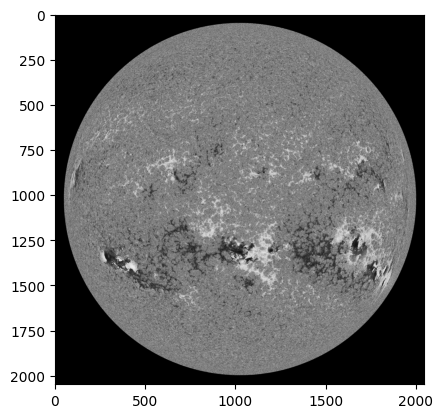

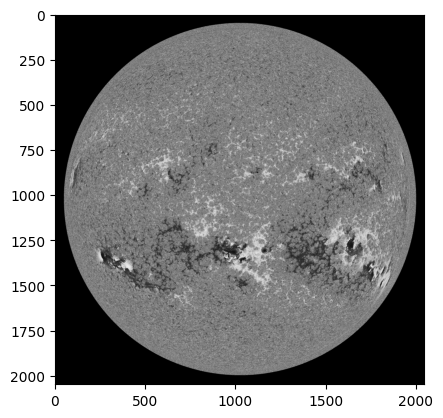

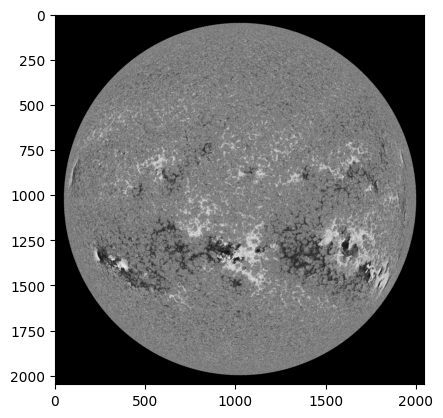

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_03_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_03_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_04_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_04_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_04_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_04_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_04_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_04_20_01_

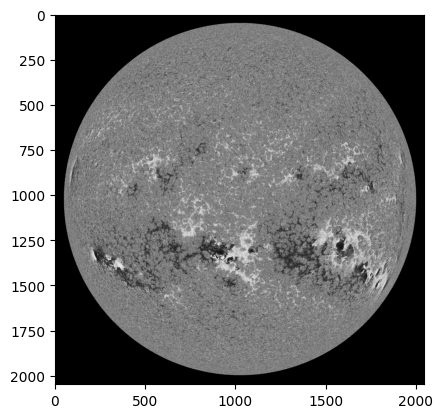

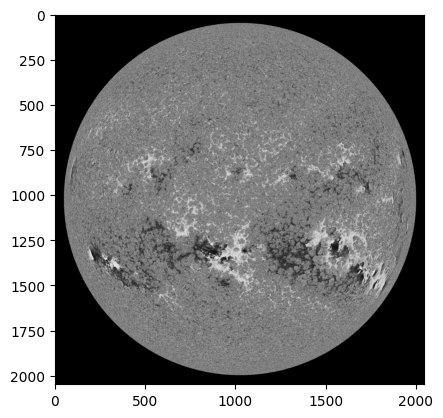

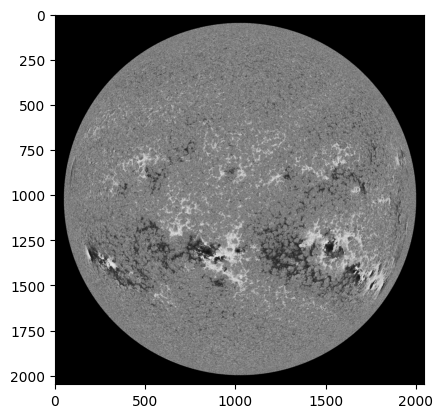

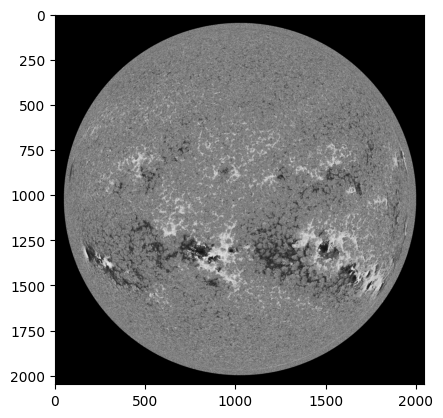

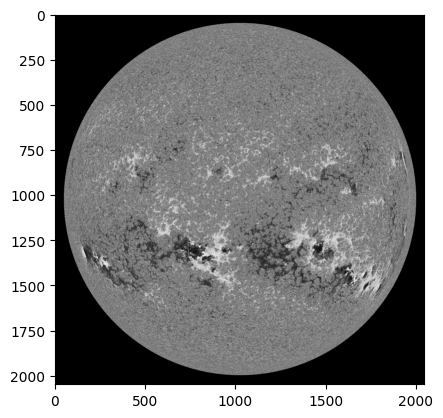

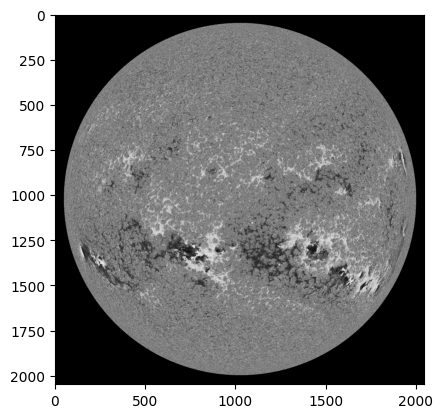

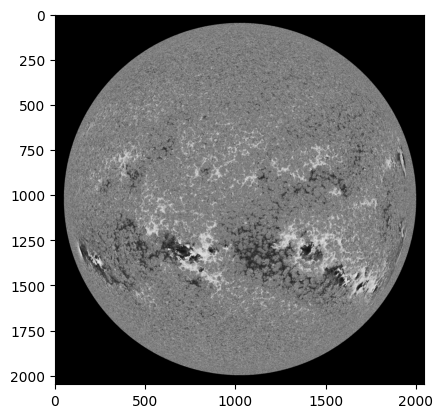

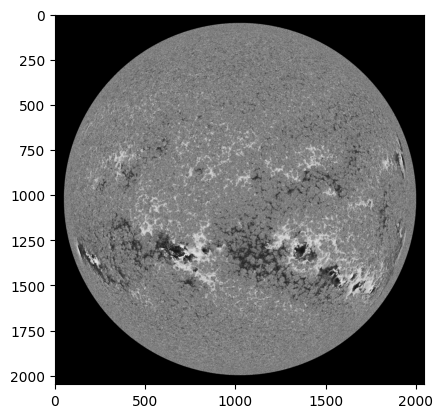

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_05_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_05_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_05_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_05_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_05_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_05_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_06_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_06_04_01_

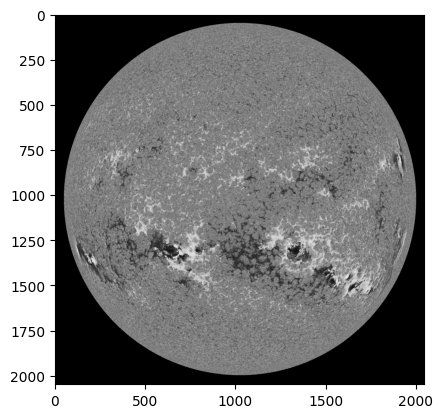

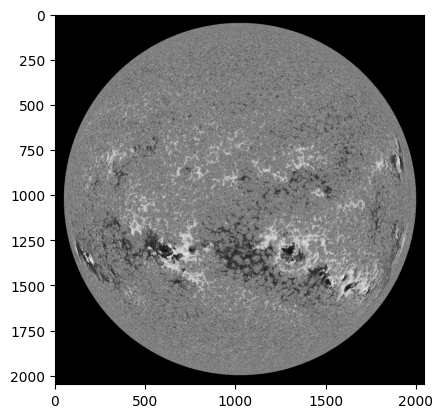

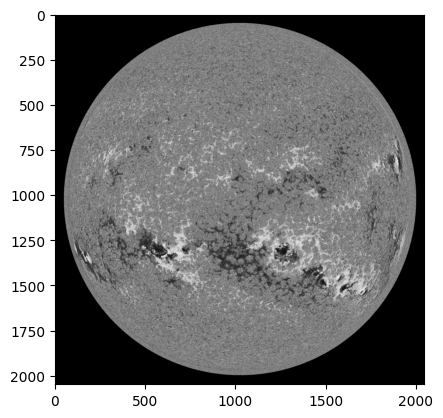

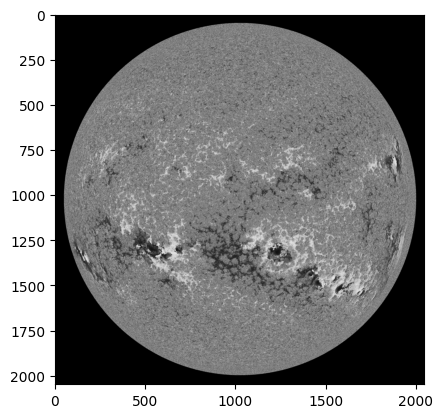

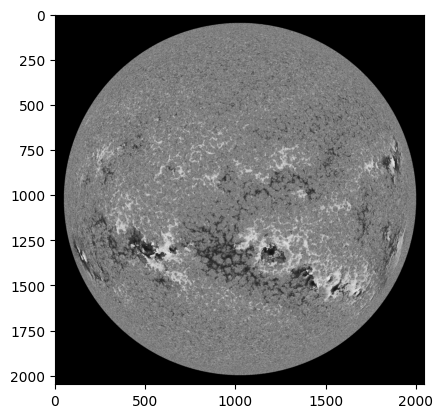

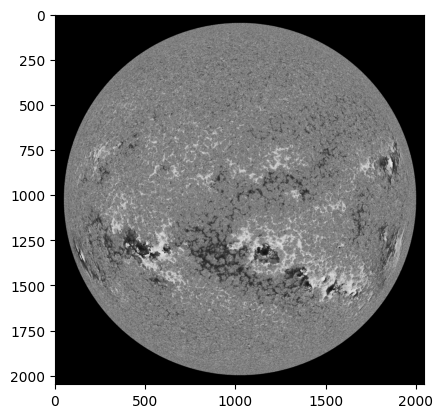

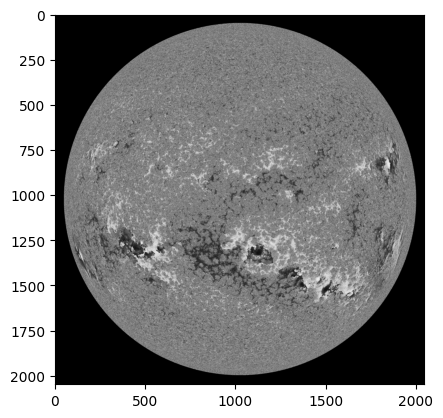

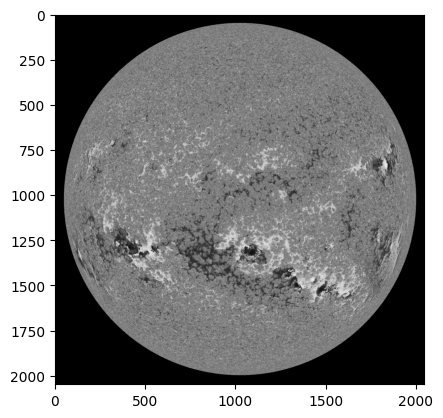

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_06_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_06_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_06_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_06_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_07_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_07_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_07_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_07_12_01_

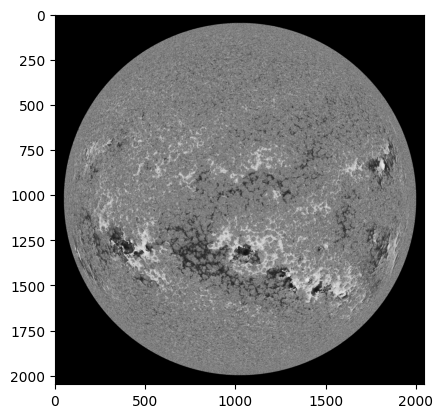

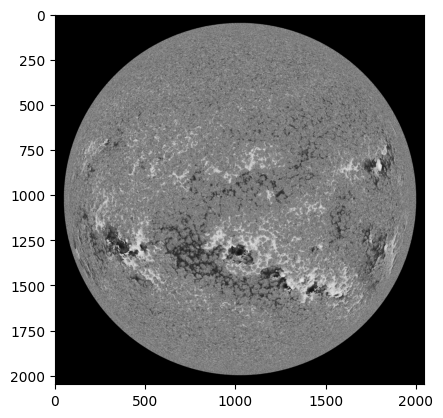

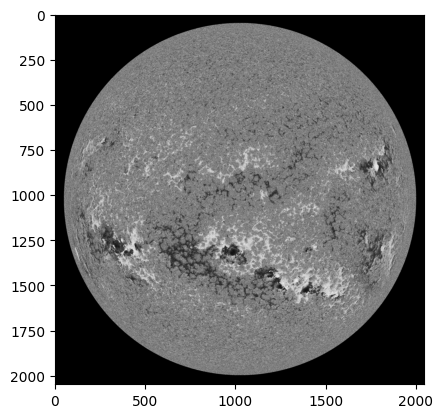

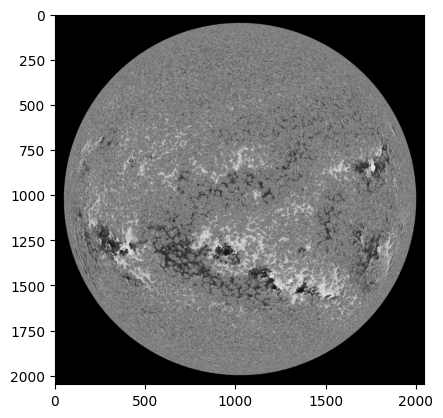

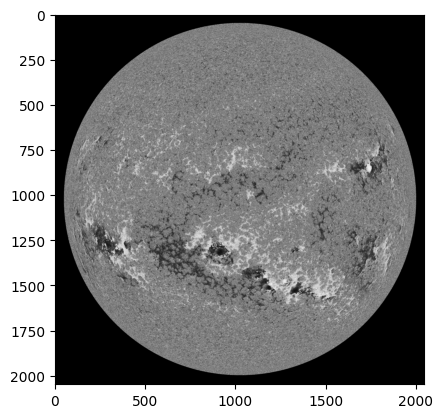

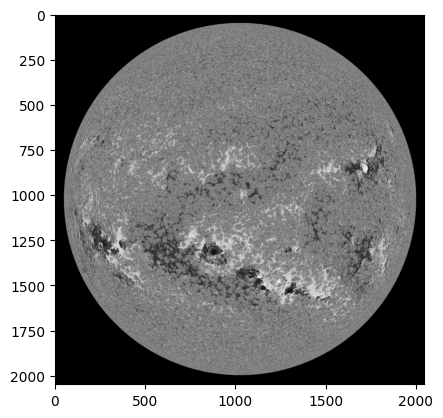

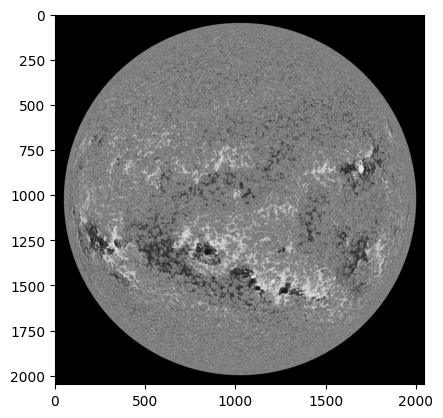

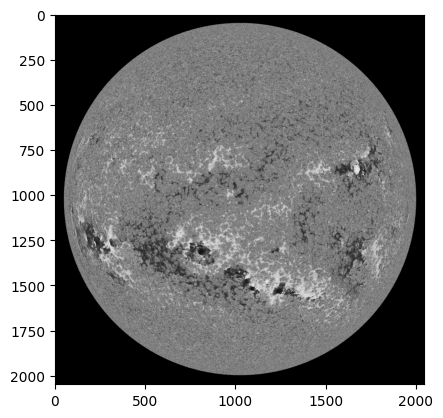

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_07_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_07_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_08_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_08_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_08_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_08_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_08_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_08_20_01_

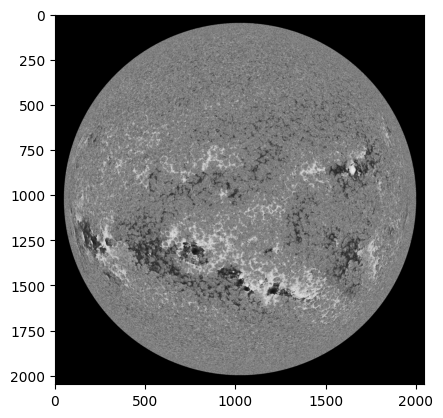

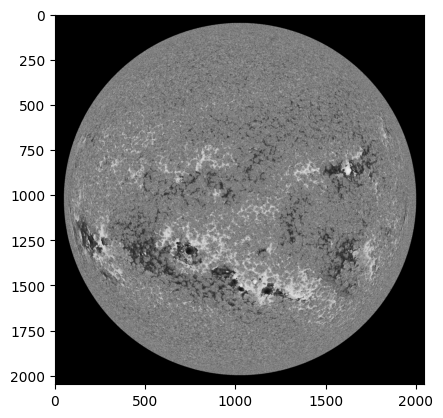

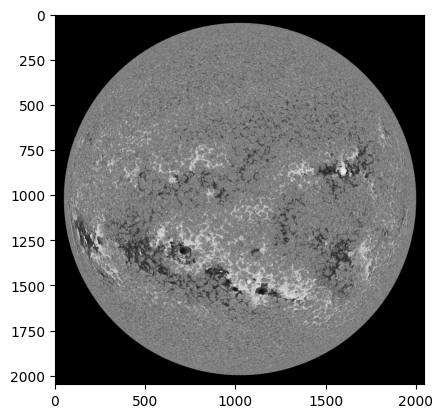

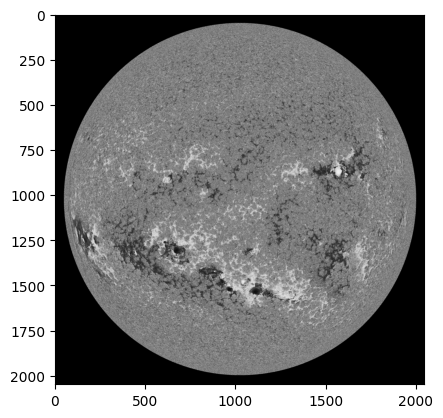

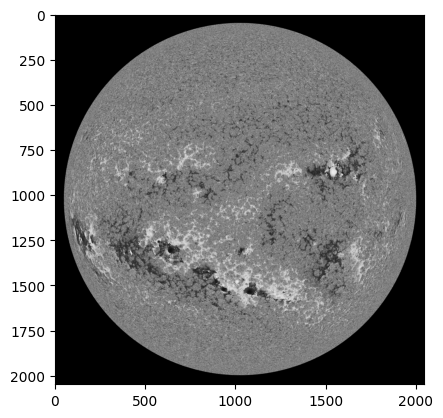

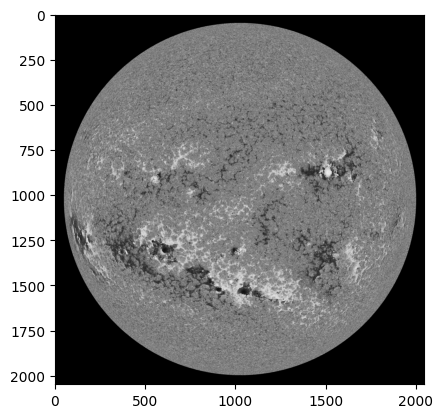

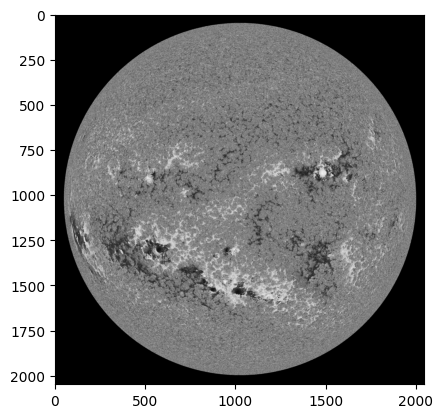

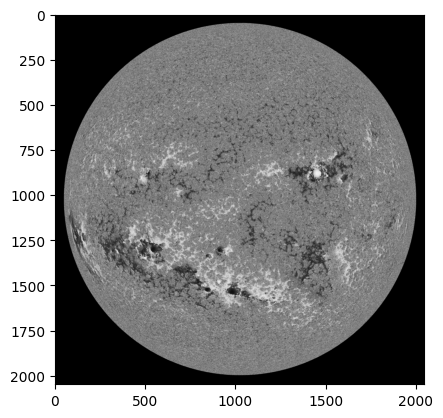

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_09_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_09_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_09_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_09_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_09_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_09_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_10_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_10_04_01_

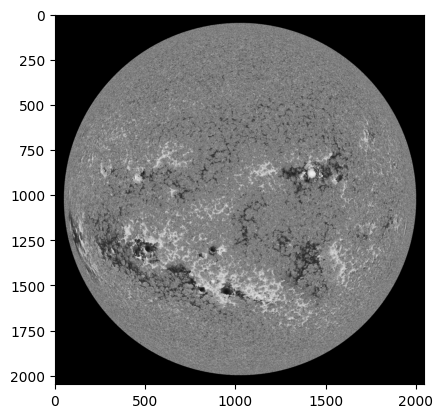

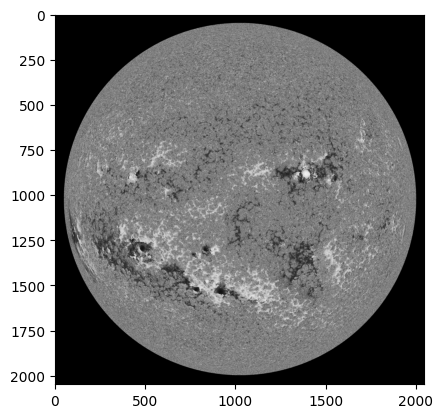

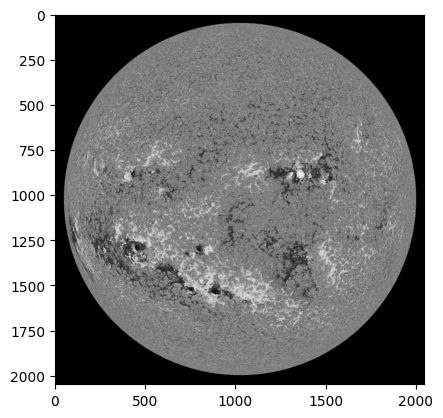

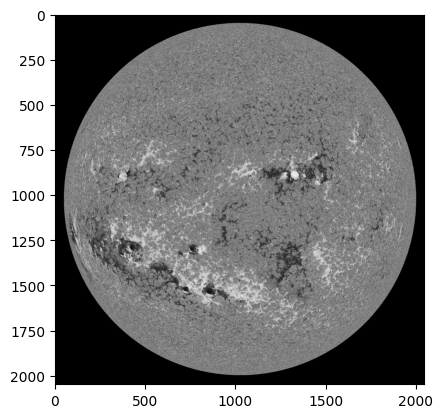

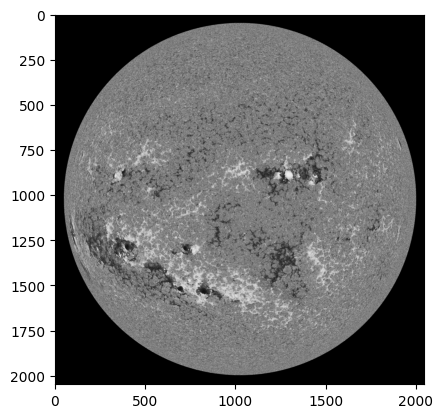

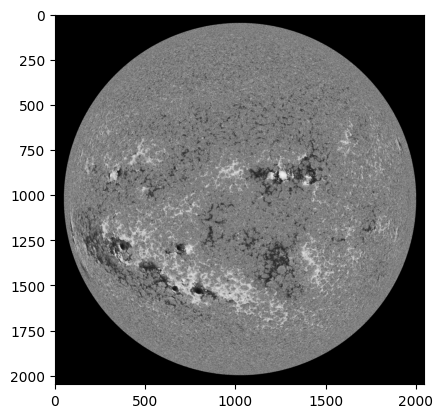

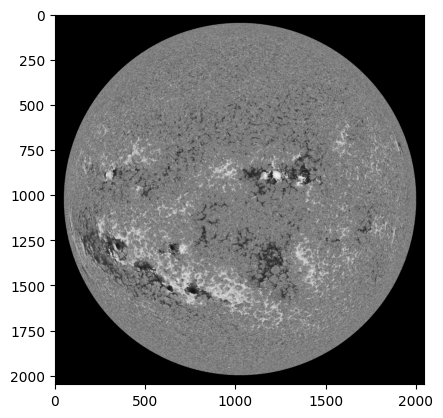

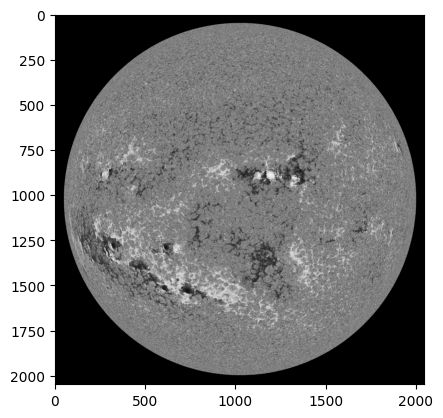

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_10_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_10_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_10_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_10_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_11_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_11_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_11_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_11_12_01_

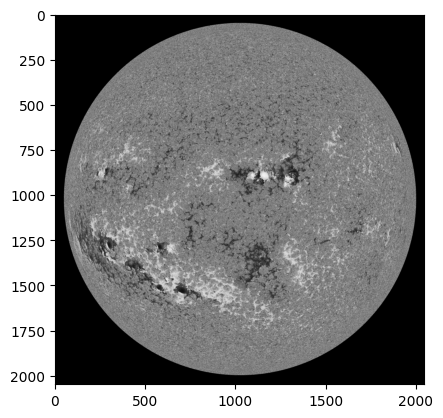

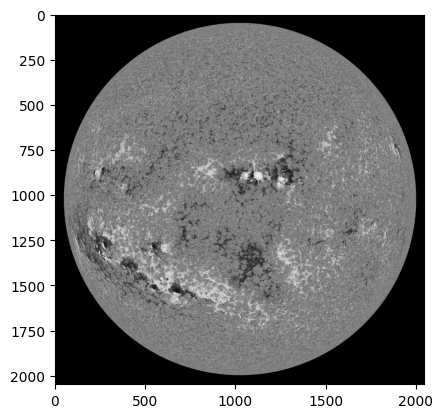

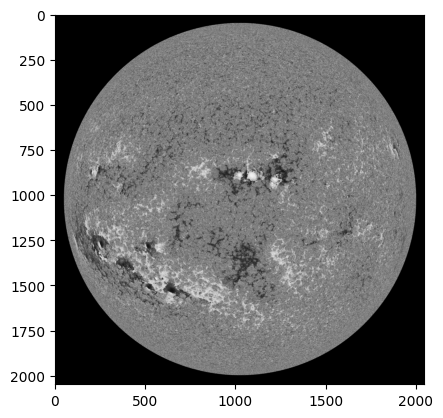

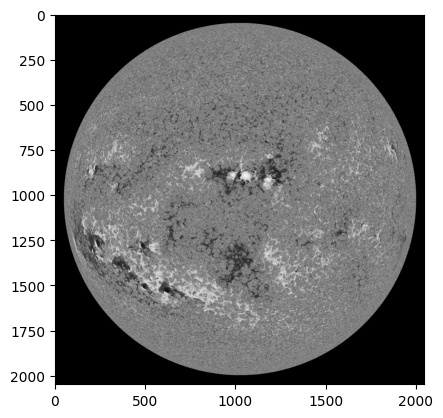

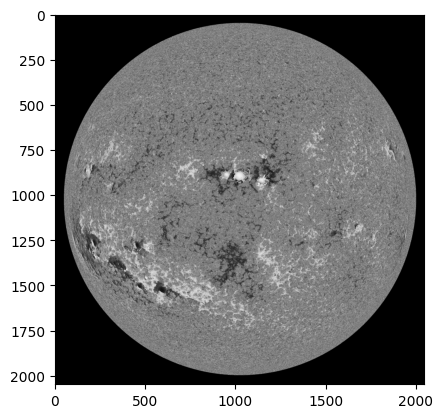

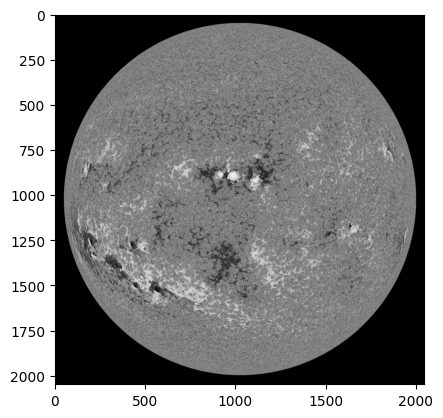

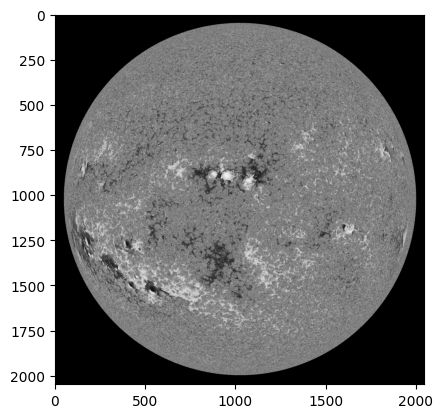

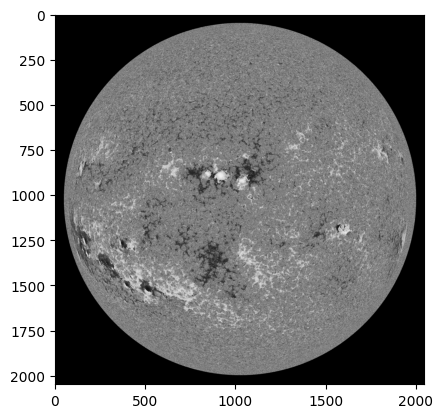

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_11_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_11_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_12_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_12_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_12_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_12_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_12_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_12_20_01_

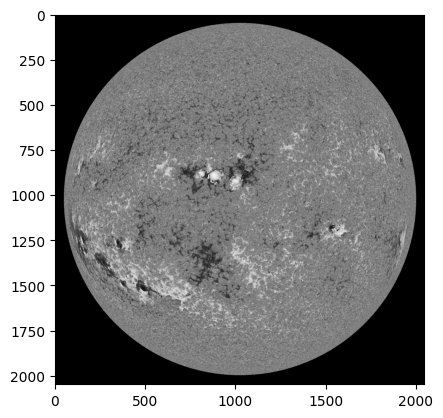

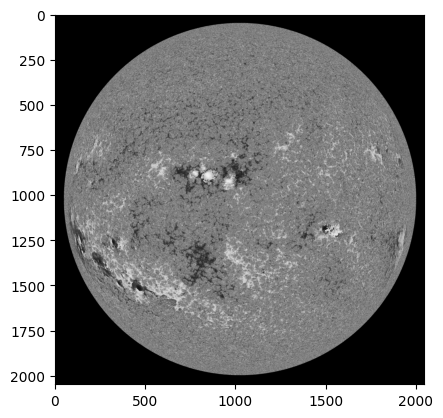

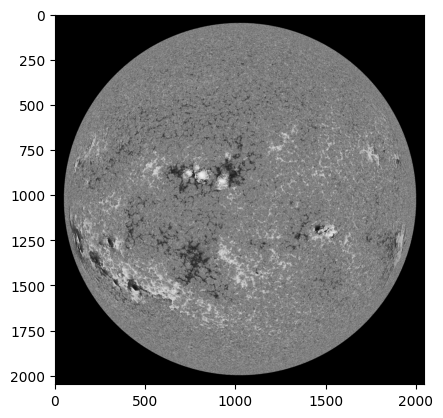

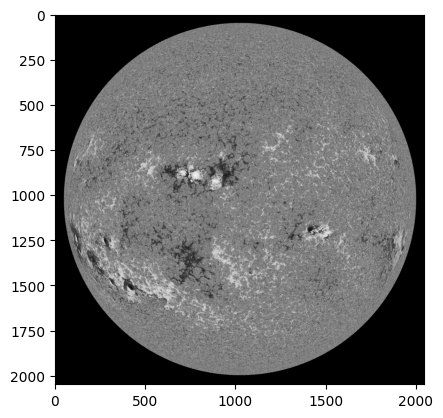

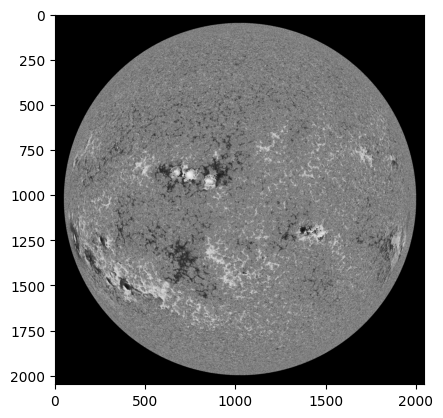

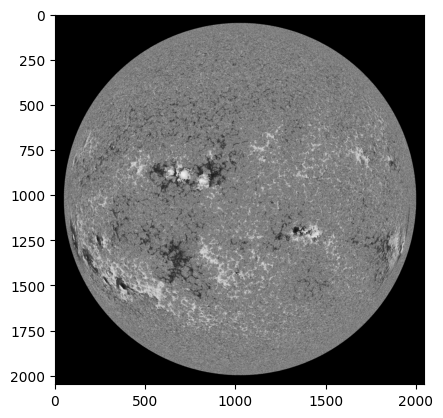

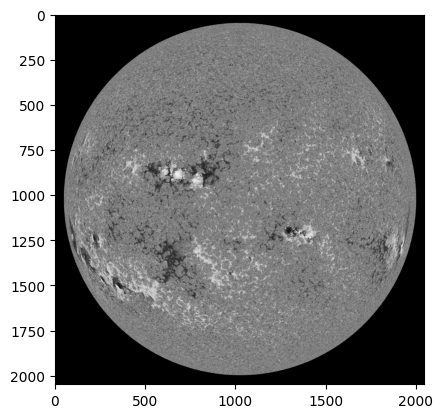

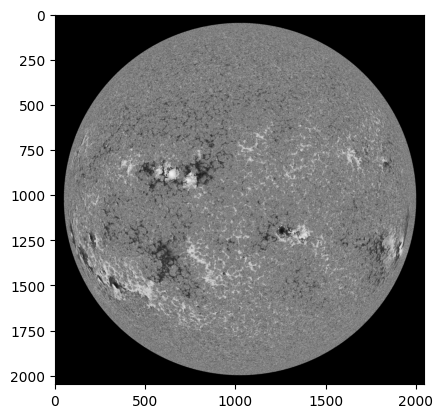

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_13_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_13_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_13_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_13_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_13_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_13_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_14_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_14_04_01_

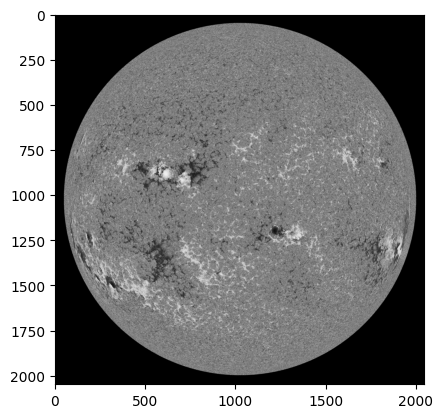

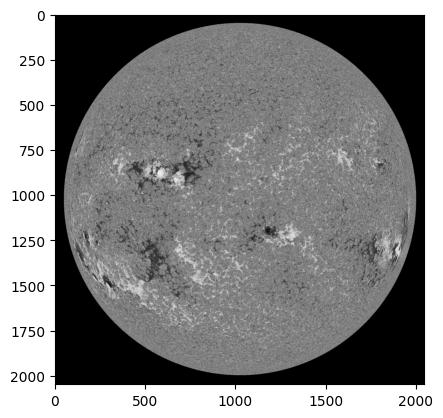

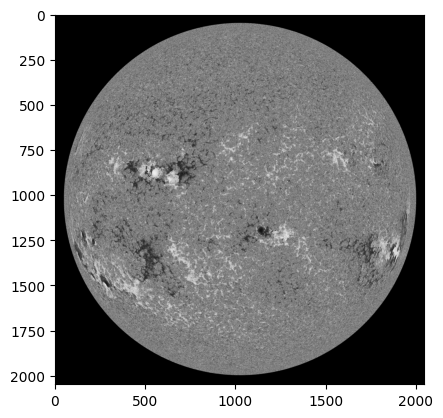

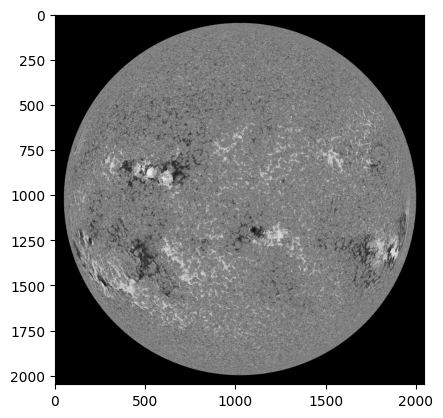

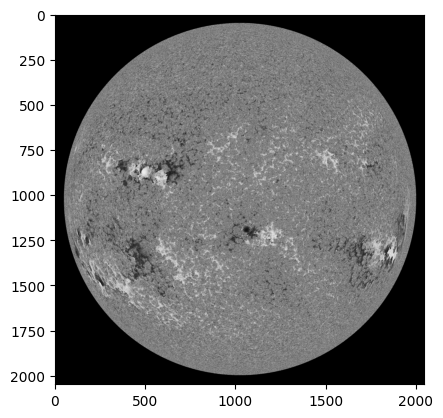

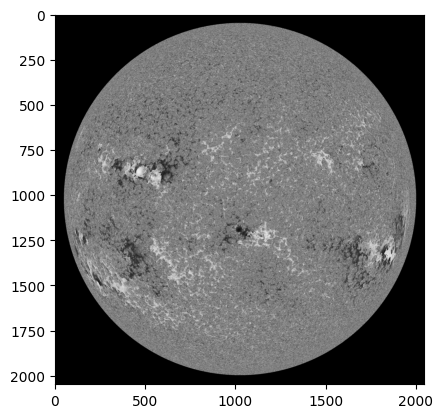

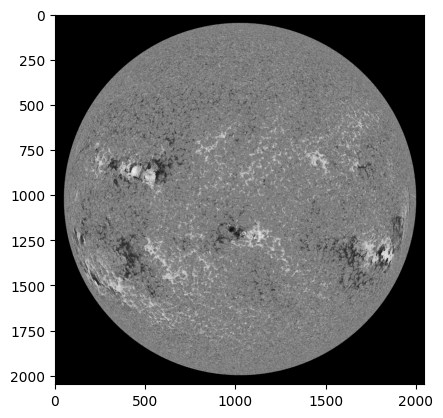

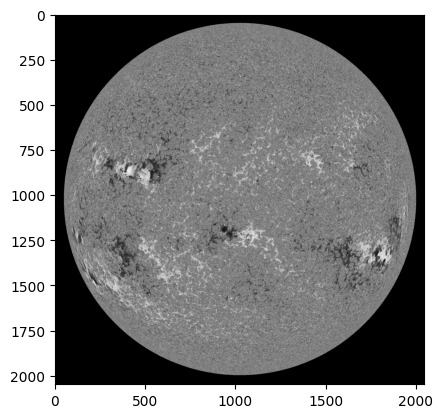

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_14_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_14_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_14_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_14_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_15_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_15_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_15_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_15_12_01_

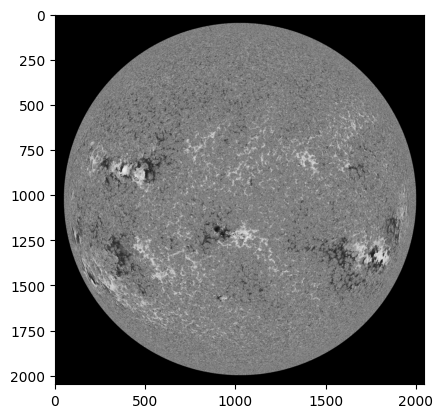

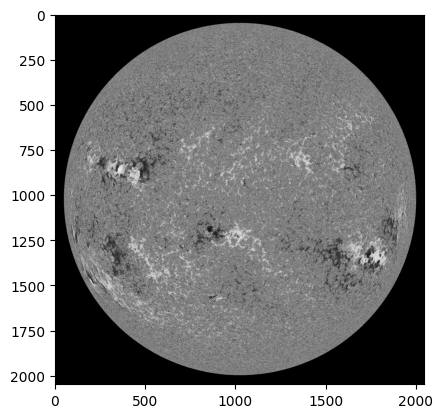

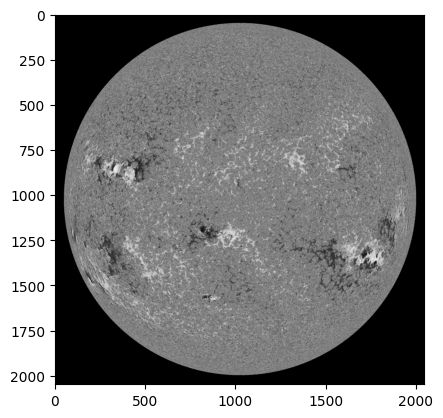

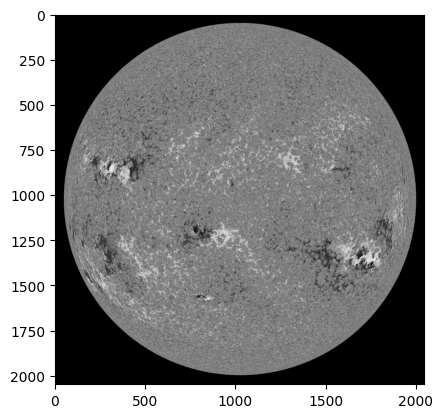

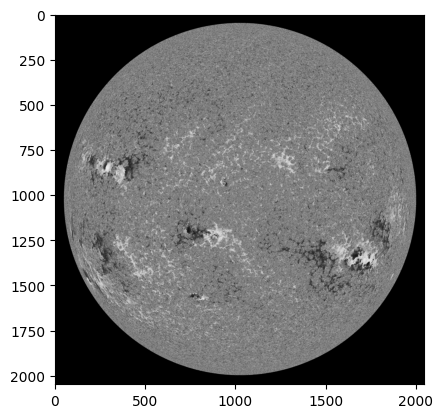

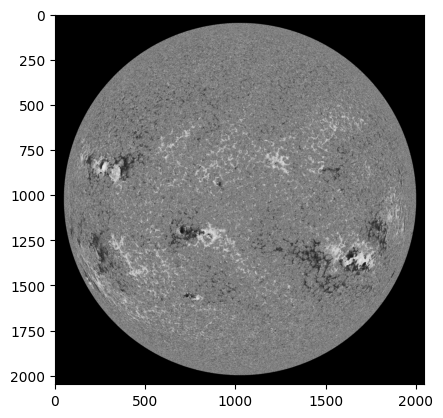

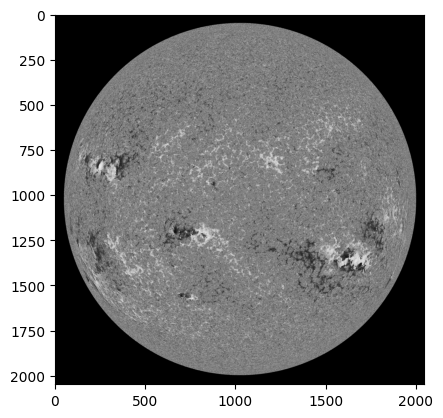

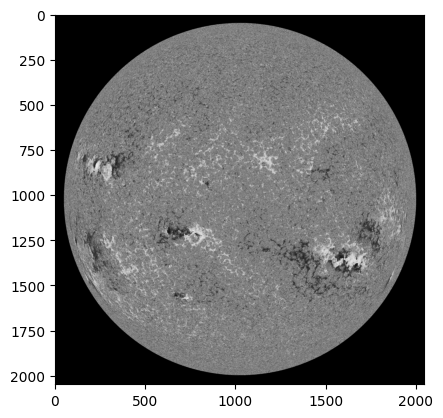

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_15_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_15_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_16_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_16_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_16_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_16_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_16_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_16_20_01_

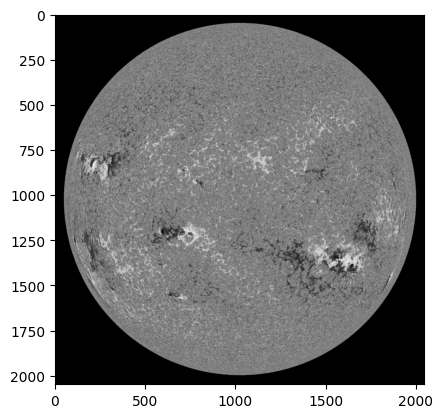

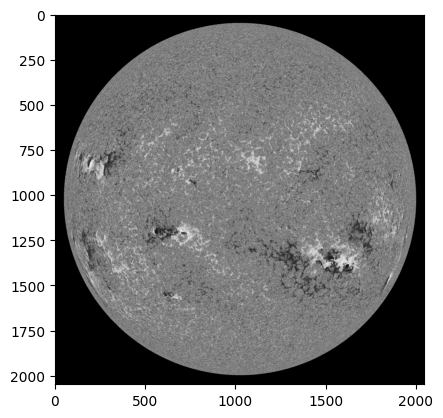

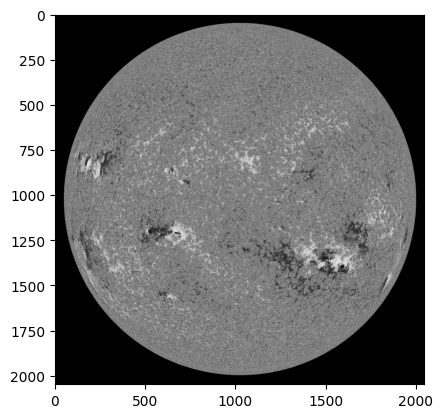

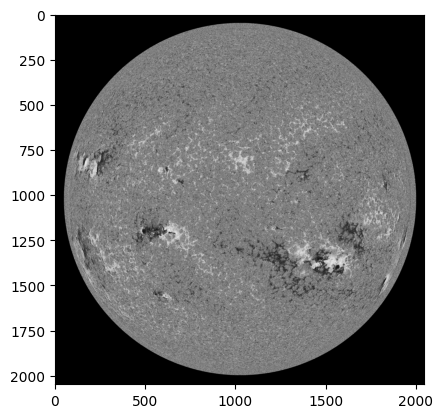

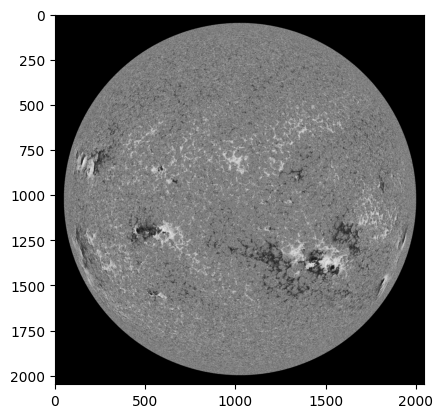

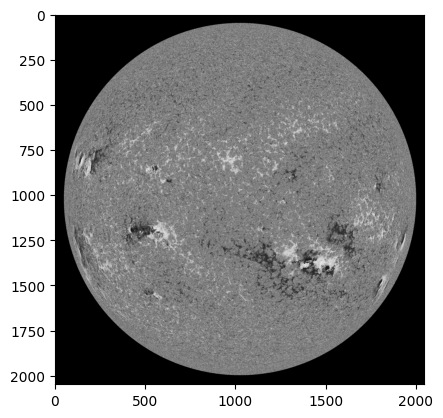

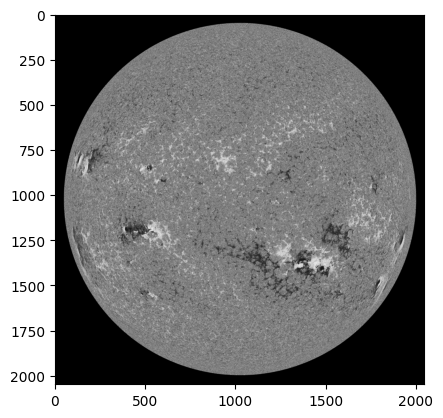

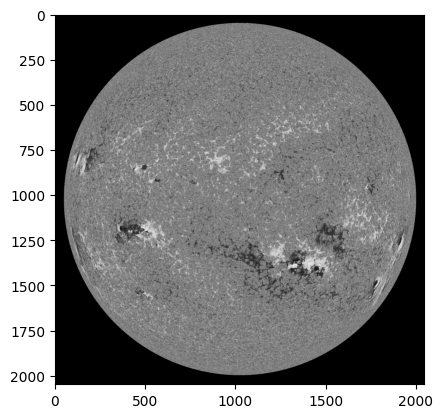

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_17_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_17_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_17_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_17_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_17_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_17_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_18_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_18_04_01_

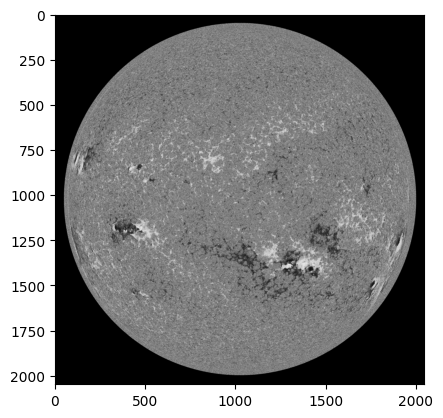

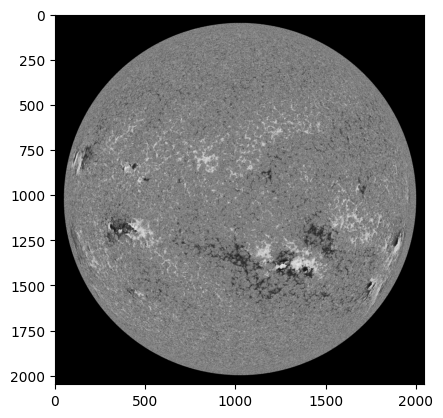

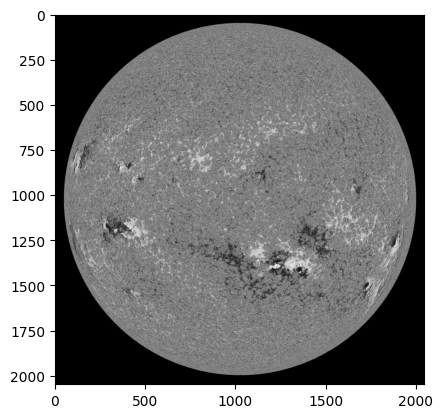

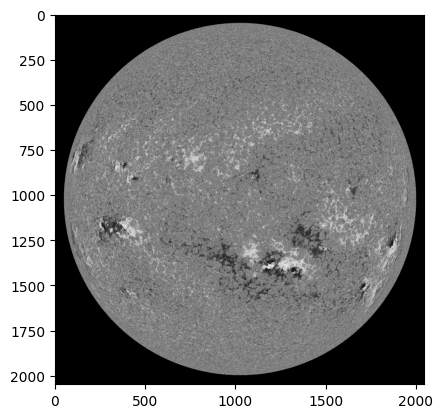

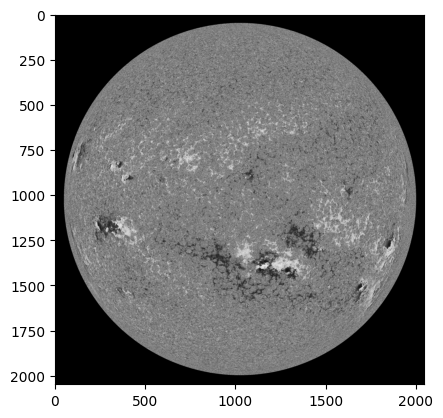

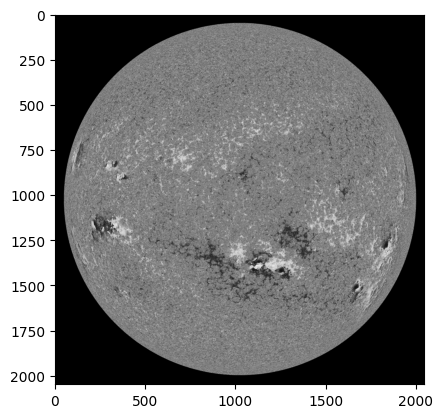

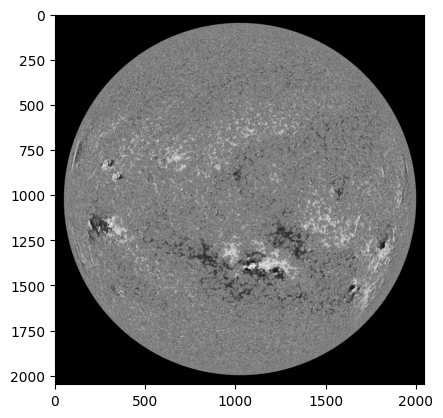

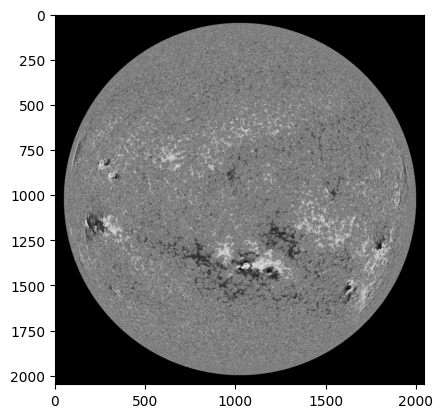

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_18_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_18_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_18_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_18_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_19_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_19_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_19_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_19_12_01_

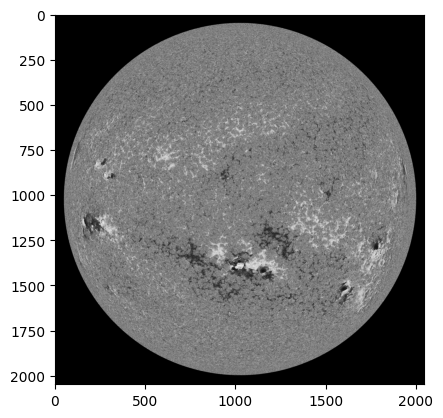

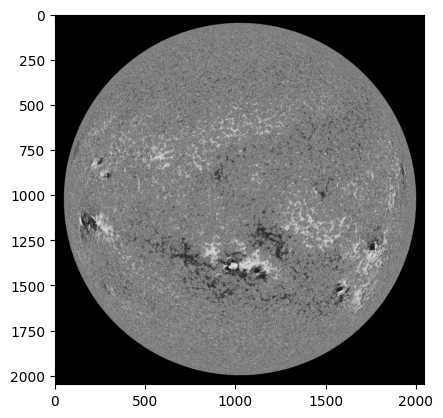

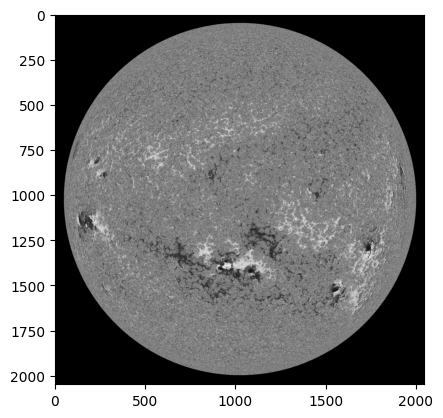

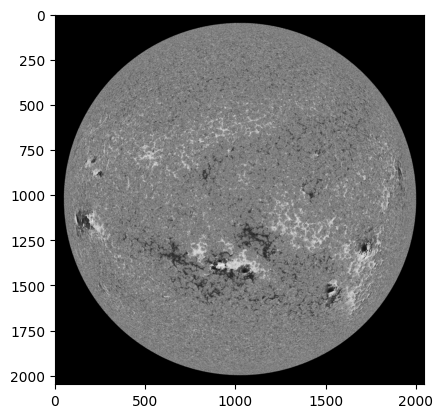

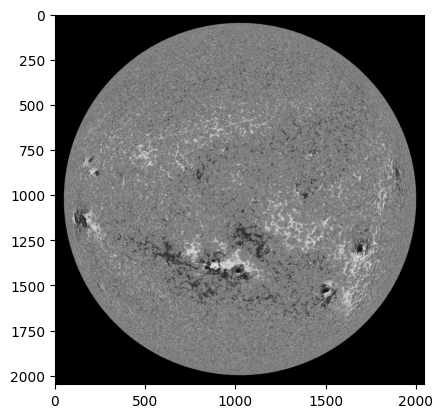

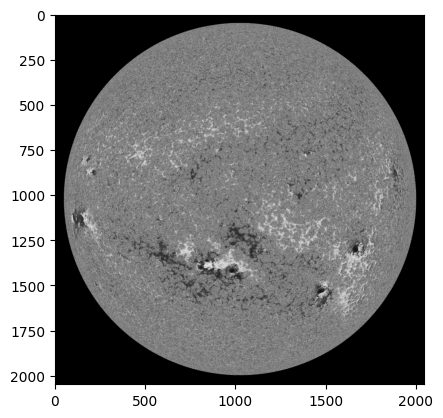

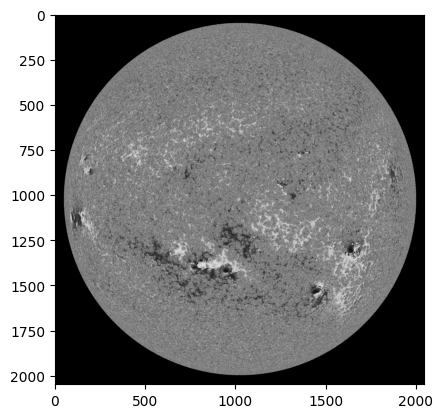

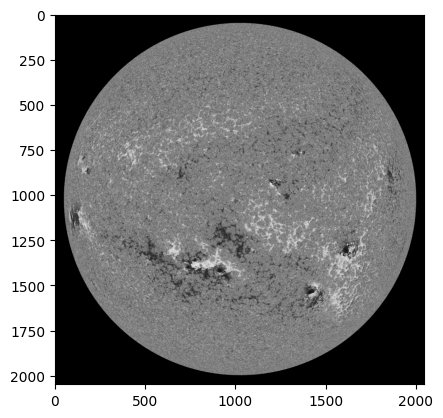

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_19_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_19_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_20_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_20_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_20_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_20_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_20_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_20_20_01_

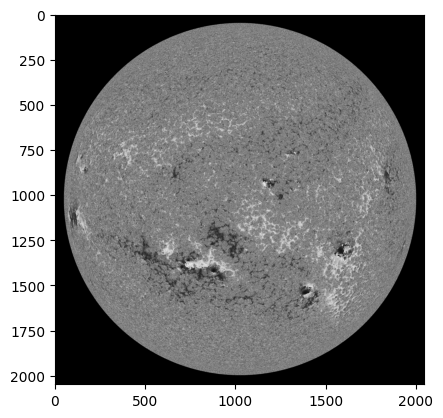

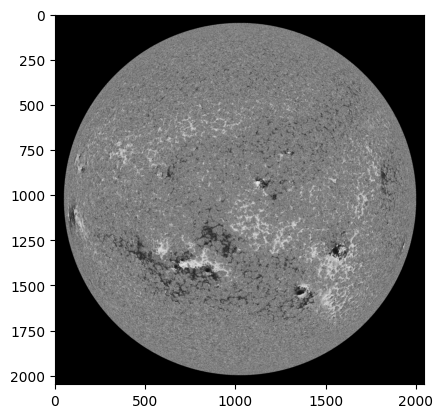

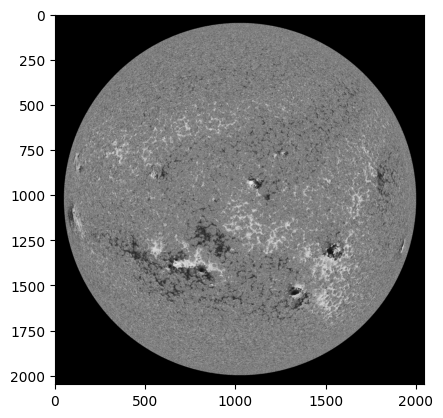

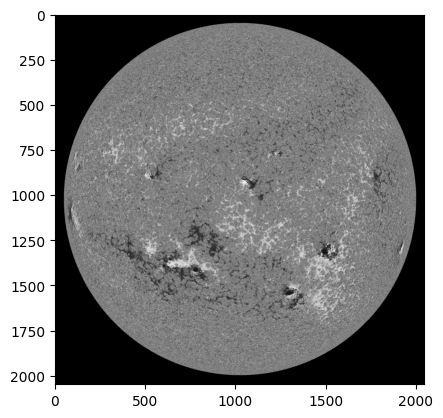

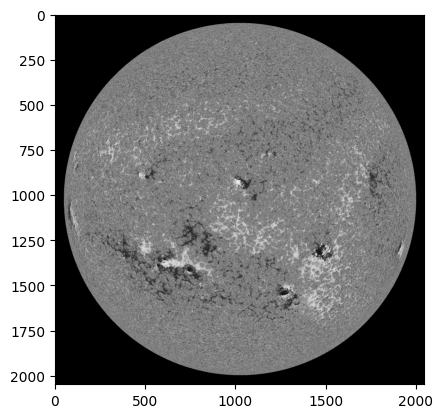

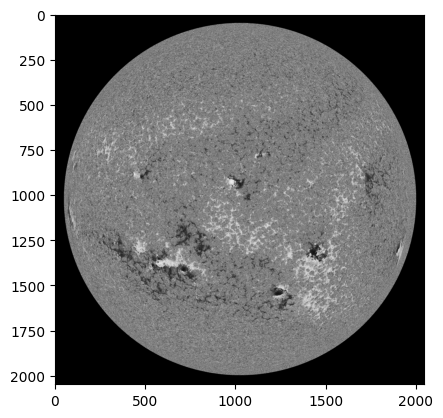

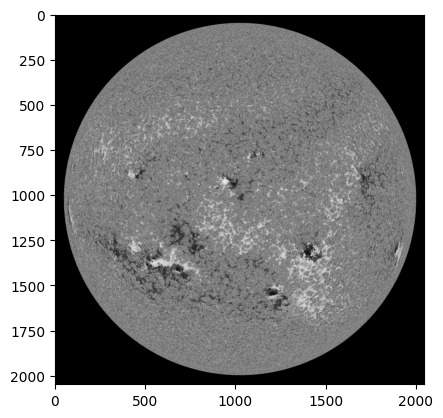

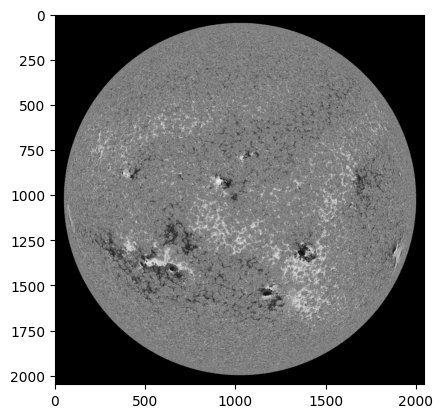

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_21_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_21_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_21_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_21_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_21_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_21_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_22_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_22_04_01_

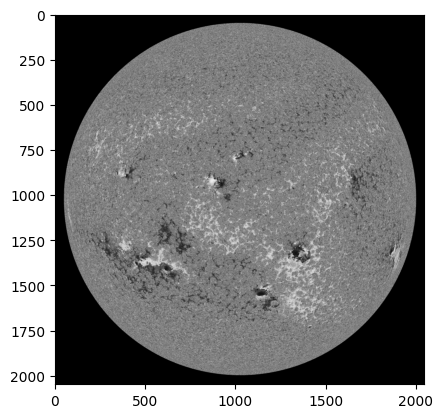

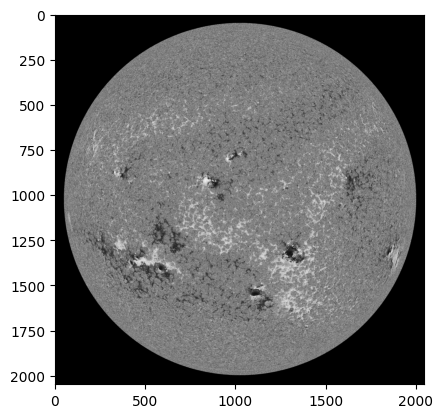

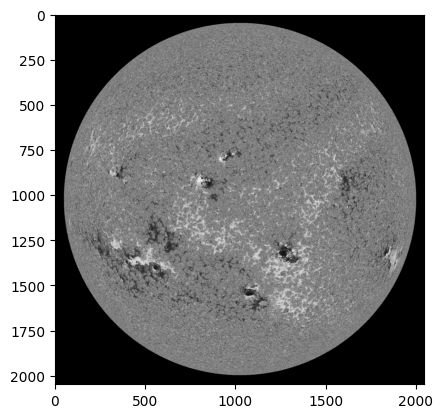

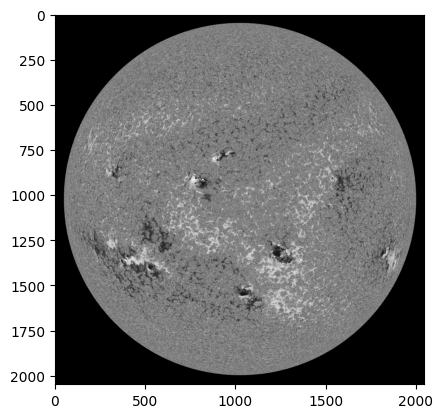

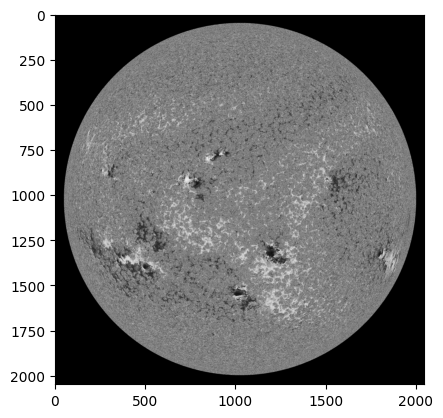

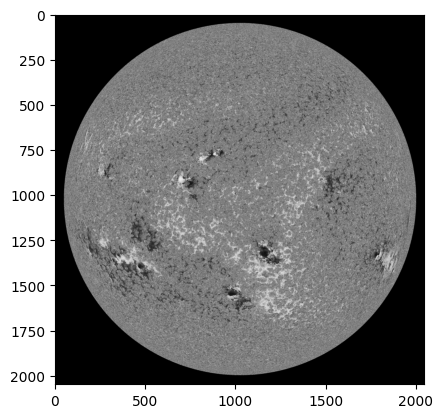

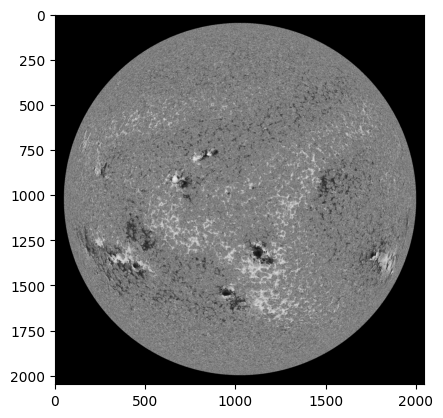

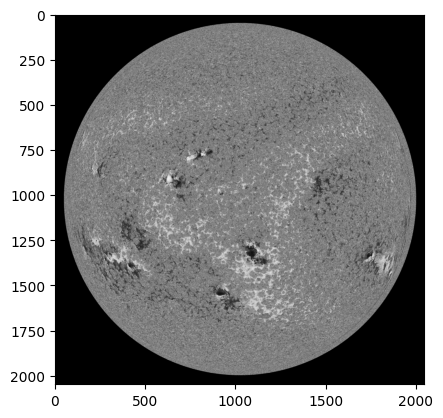

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_22_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_22_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_22_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_22_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_23_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_23_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_23_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_23_12_01_

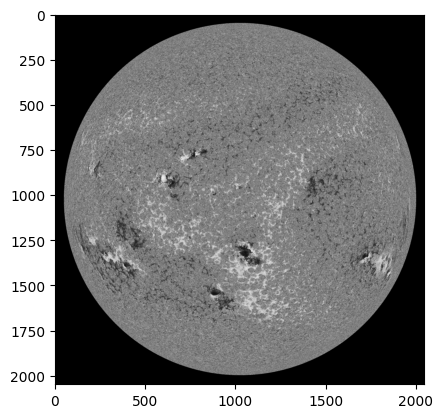

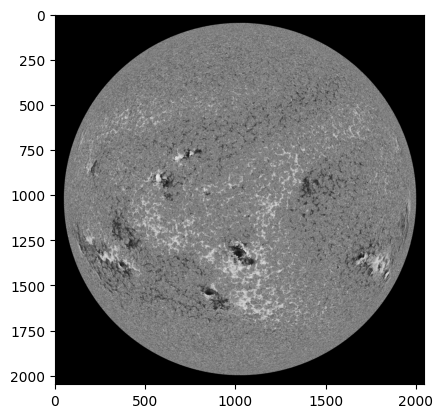

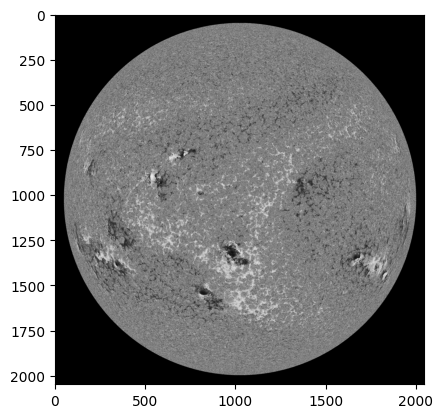

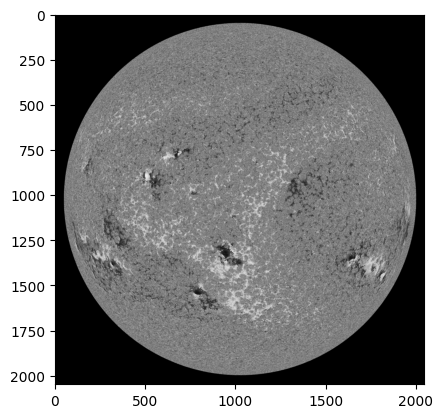

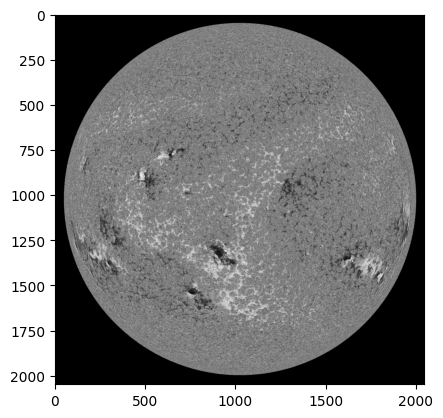

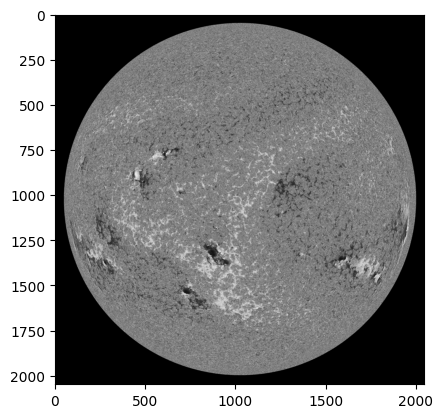

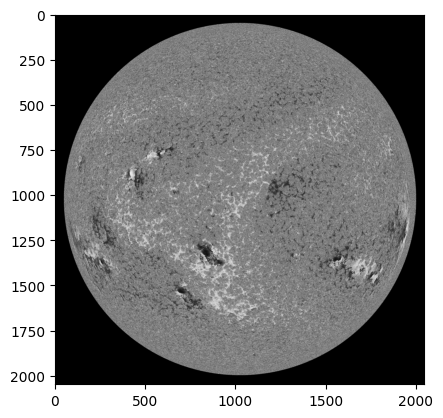

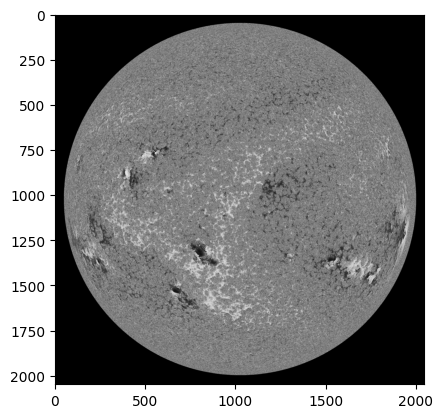

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_23_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_23_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_24_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_24_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_24_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_24_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_24_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_24_20_01_

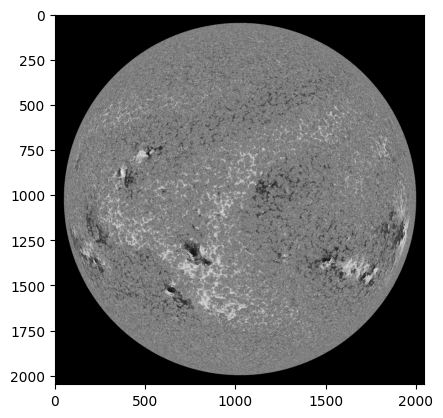

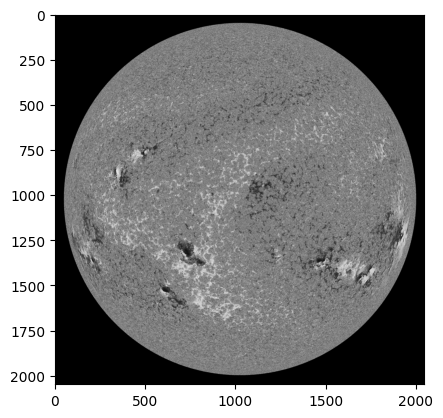

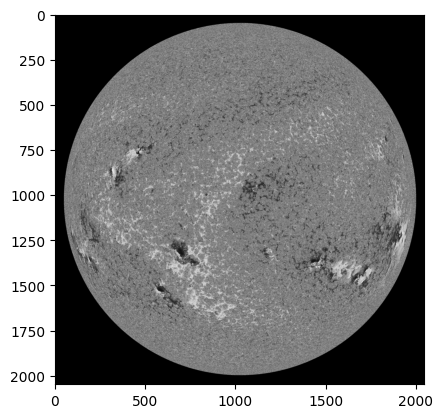

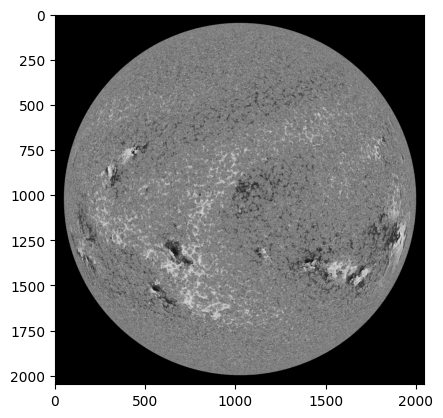

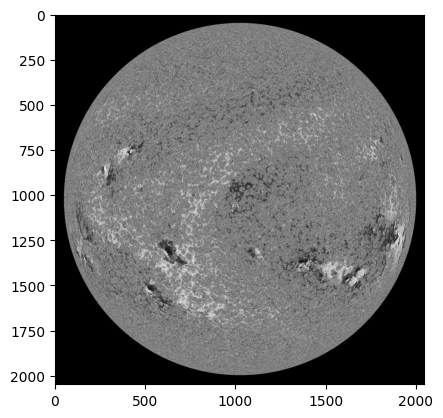

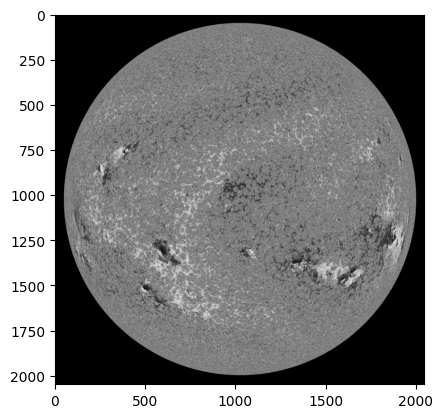

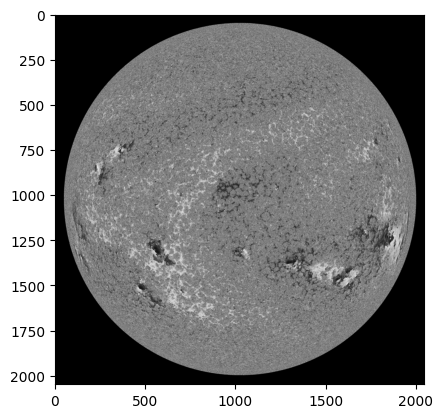

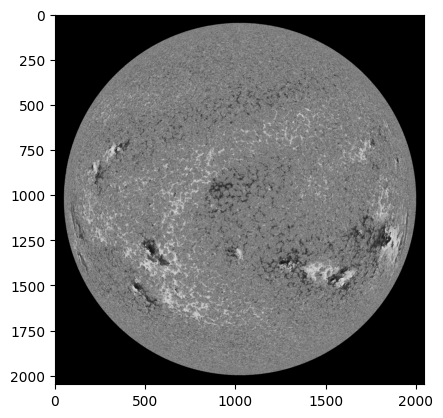

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_25_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_25_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_25_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_25_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_25_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_25_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_26_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_26_04_01_

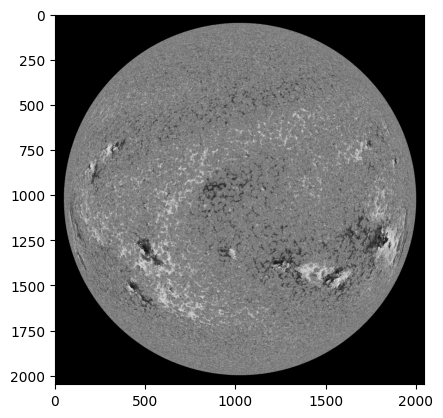

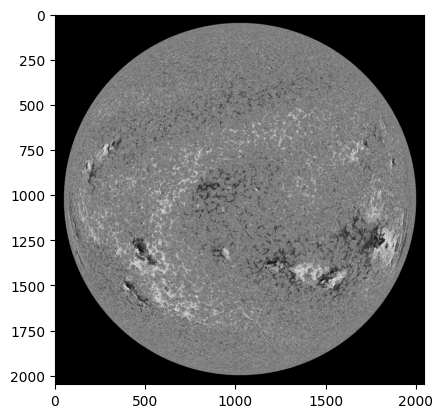

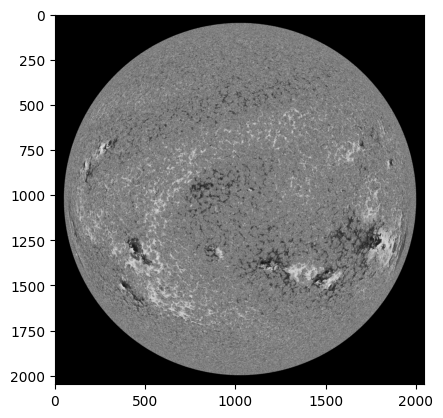

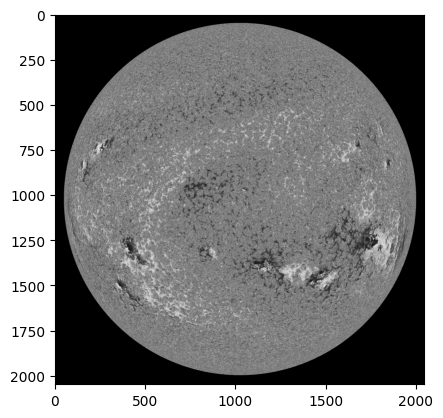

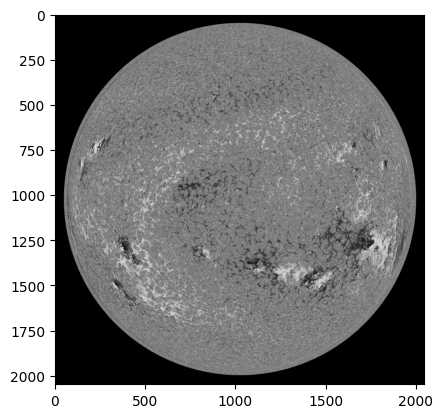

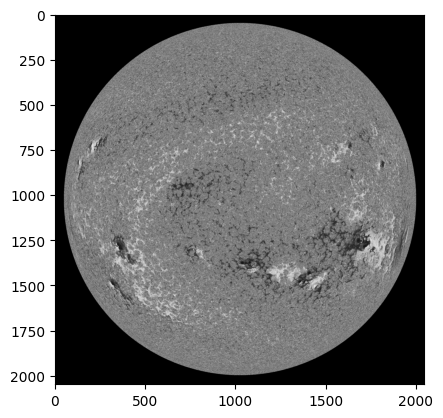

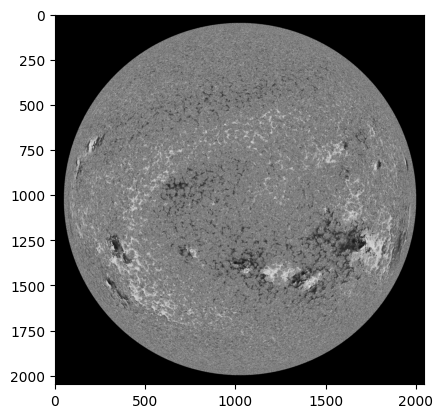

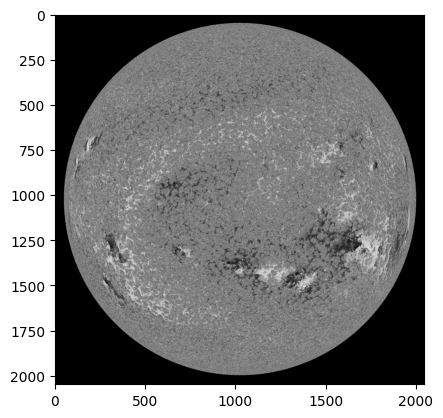

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_26_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_26_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_26_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_26_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_27_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_27_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_27_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_27_12_01_

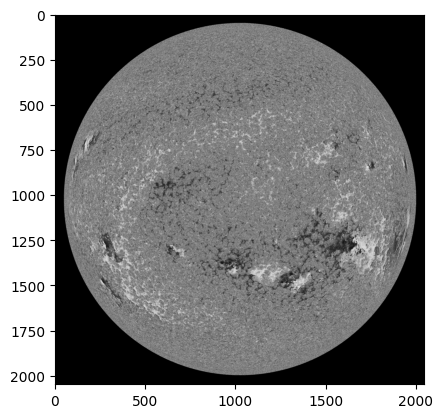

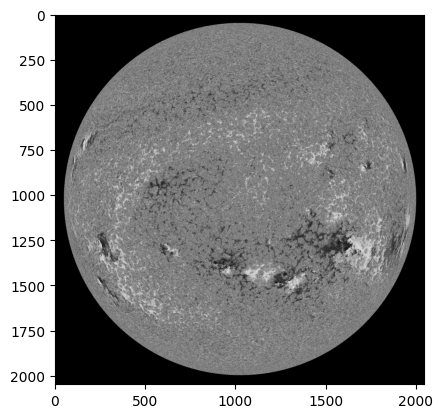

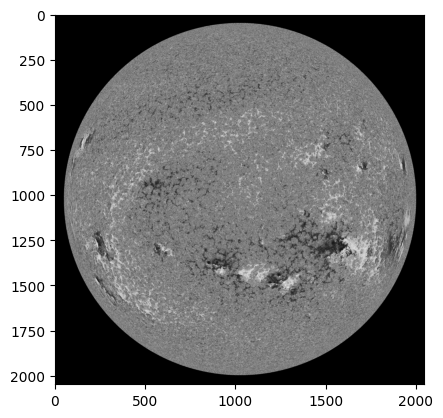

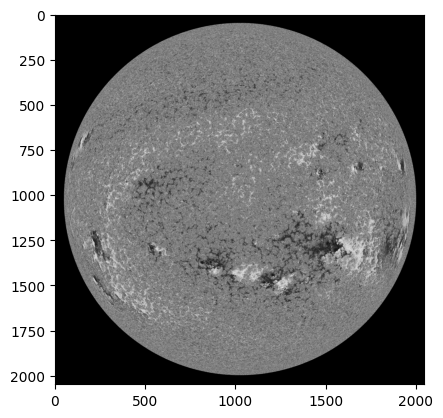

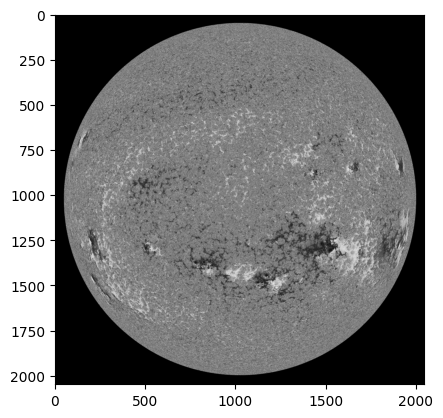

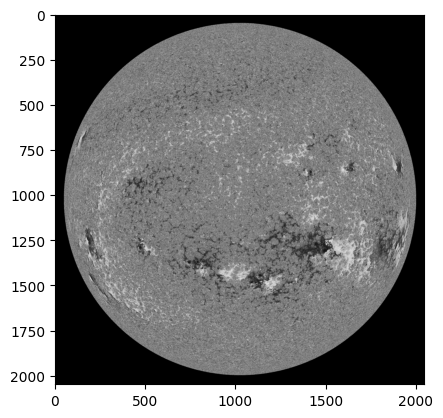

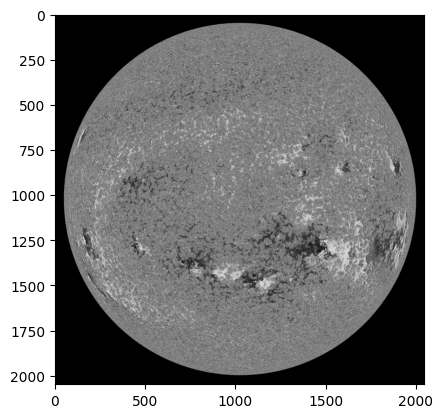

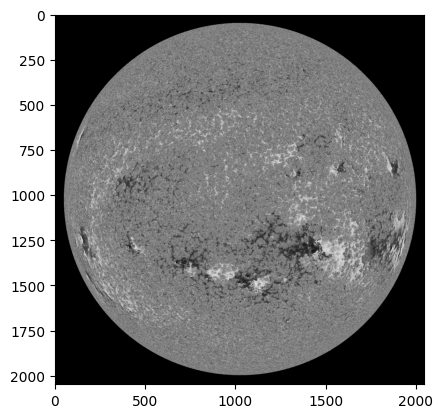

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_27_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_27_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_28_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_28_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_28_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_28_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_28_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_28_20_01_

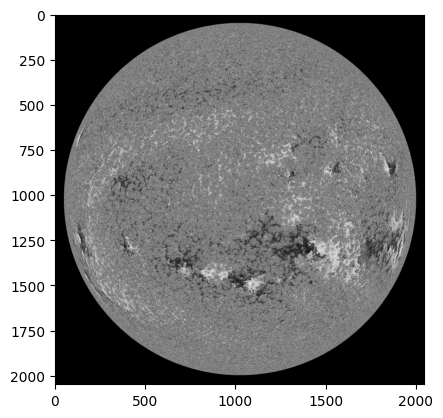

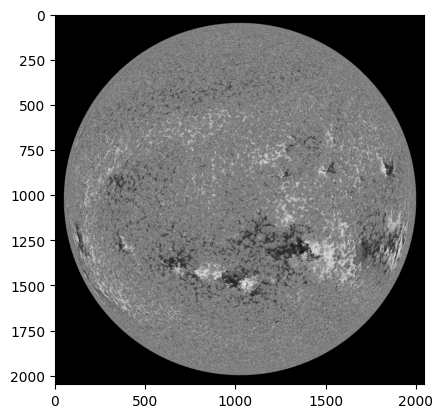

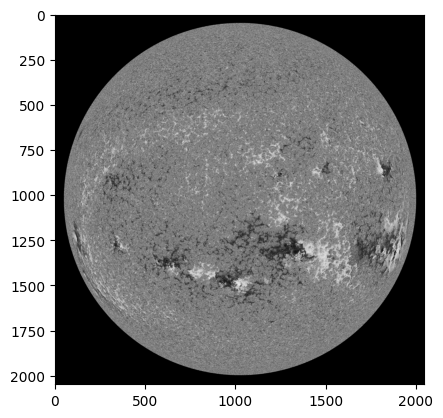

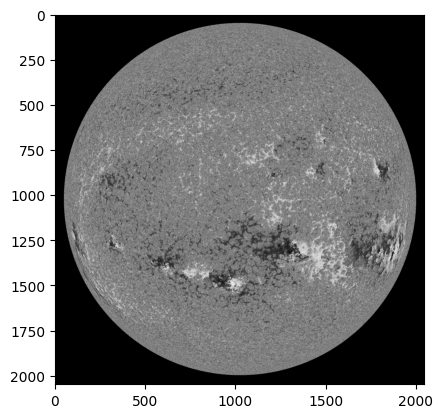

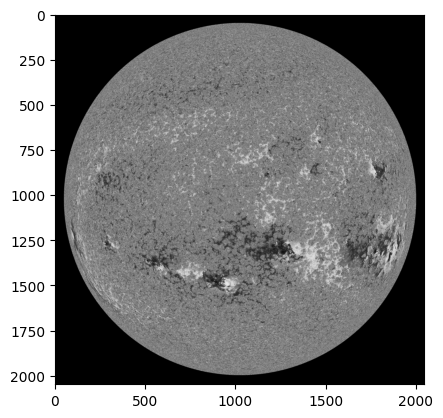

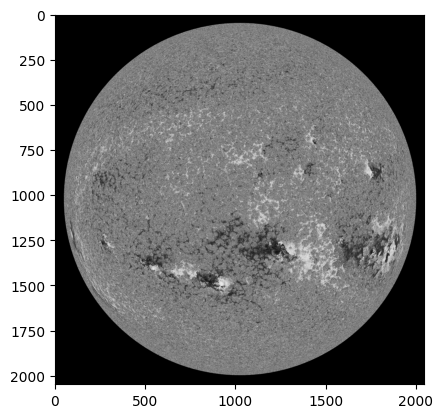

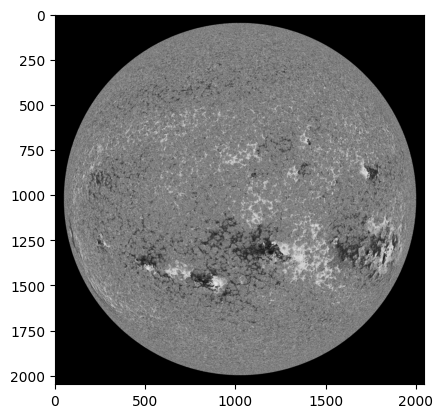

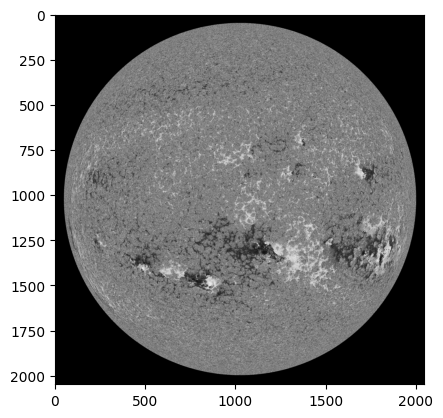

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_29_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_29_04_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_29_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_29_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_29_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_29_20_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_30_00_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_30_04_01_

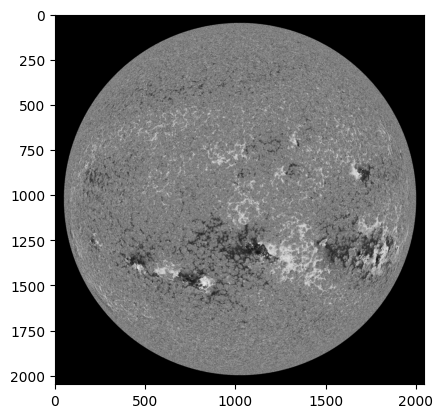

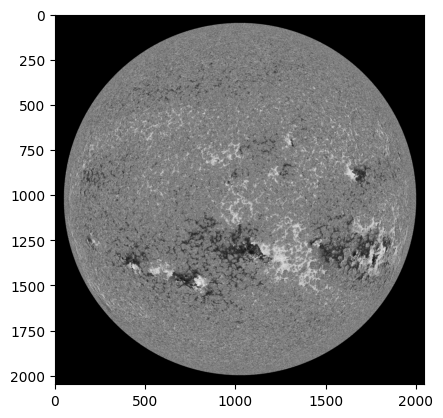

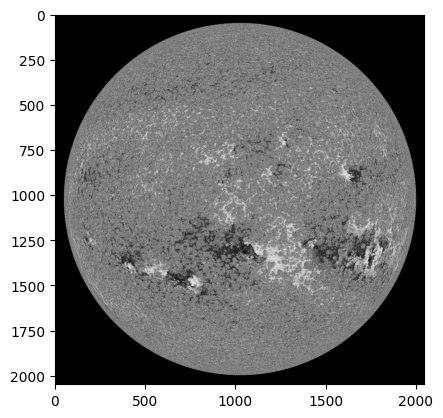

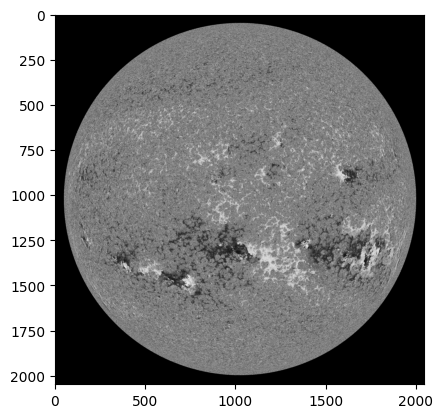

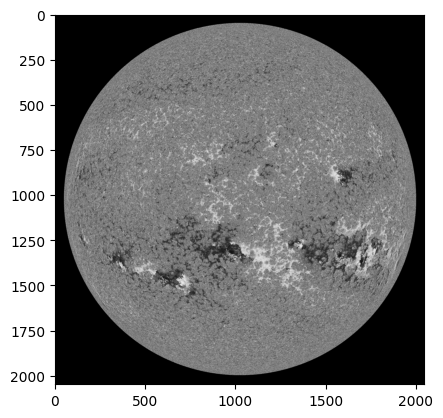

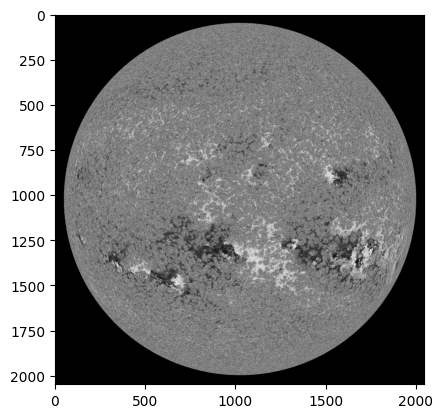

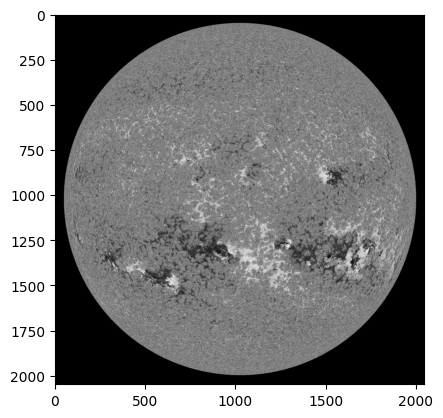

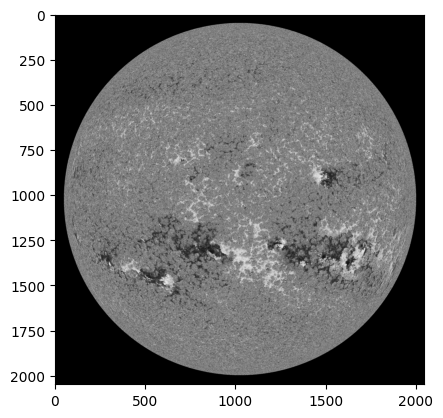

/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_30_08_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_30_12_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_30_16_01_30_tai_magnetogram.fits
/Users/reza/Career/DMLab/AR TRACKING/ar-track/data/HEK-JSOC/2024_test/images/hmi_m_45s_2024_09_30_20_01_30_tai_magnetogram.fits


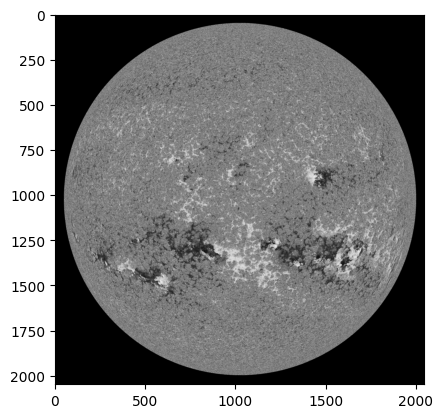

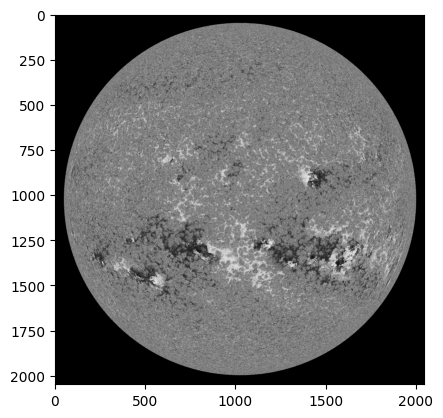

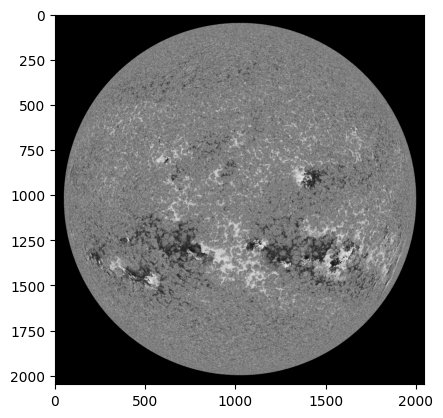

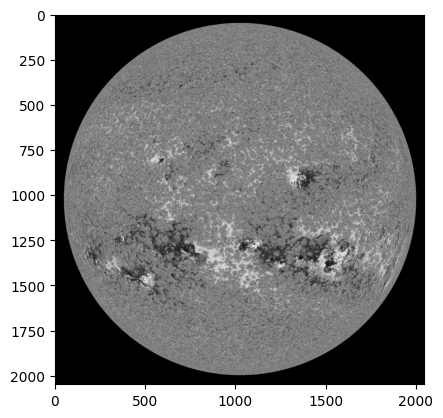

In [5]:
for x, y in loader:
    for xx in x:
        plt.imshow(xx[0], cmap='gray')
        plt.show()